<a href="https://colab.research.google.com/github/Don-Nicholas/KITHY-Chatbot/blob/master/FCLB_TFOD.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Import and Install Modules and Libraries

In [1]:
!pip install wget
!git clone https://github.com/DonJM/FCLB_Dataset.git
!git clone https://github.com/DonJM/Setup.git

#import neccessary python modules and libraries
import os
import shutil
from FCLB_Dataset.FCLB_Dataset import FCLB_Datasets
from Setup.Setup import Setup_Path
import wget

  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9672 sha256=ba5d4b5d44815db3a5a3bacf97a6816ab229654189ad12f96c1058af3415b37b
  Stored in directory: /root/.cache/pip/wheels/a1/b6/7c/0e63e34eb06634181c63adacca38b79ff8f35c37e3c13e3c02
Successfully built wget
Cloning into 'FCLB_Dataset'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 3 (delta 0), reused 3 (delta 0), pack-reused 0
Unpacking objects: 100% (3/3), done.
Cloning into 'Setup'...
remote: Enumerating objects: 9, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (6/6), done.
remote: Total 9 (delta 3), reused 1 (delta 0), pack-reused 0
Unpacking objects: 100% (9/9), done.


# Preparing Workspace

Creating a workspace directory

In [2]:
setup = Setup_Path()
workspaces = setup.getWorkspaces()
files = setup.files(
    'ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8', 
    'http://download.tensorflow.org/models/object_detection/tf2/20200711/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8.tar.gz'
    )
for workspace in workspaces.values():
  if not os.path.exists(workspace):
    os.makedirs(workspace)
         

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Image Augmentation

Create label directory for original images and preprocessed images

segment images and copy to preprocessed directory

In [ ]:
dataset = FCLB_Datasets(setup)
dataset.segment()

# Image Labelling

Compress of Image Labeling

In [ ]:
TRAIN_PATH = workspaces['TRAINING_IMAGES_PATH']
TEST_PATH = workspaces['TESTING_IMAGES_PATH']
VALID_PATH = workspaces['VALIDATION_IMAGES_PATH']
ARCHIVE_PATH = os.path.join(workspaces['IMAGES_PATH'], 'archive.tar.gz')

In [ ]:
!tar -czf {ARCHIVE_PATH} {TRAIN_PATH} {TEST_PATH} {VALID_PATH}

# Download Tensorflow Object Detection API

In [4]:
tfod_api = workspaces['TFOD_API_PATH']
!cd {tfod_api} && git clone https://github.com/tensorflow/models.git

Cloning into 'models'...
remote: Enumerating objects: 66182, done.
remote: Counting objects: 100% (162/162), done.
remote: Compressing objects: 100% (55/55), done.
remote: Total 66182 (delta 125), reused 140 (delta 107), pack-reused 66020
Receiving objects: 100% (66182/66182), 575.80 MiB | 28.13 MiB/s, done.
Resolving deltas: 100% (46336/46336), done.


# Install Object Detection

In [5]:
research_path = os.path.join(workspaces['TFOD_API_PATH'], 'models', 'research')
!cd {research_path} && cp object_detection/packages/tf2/setup.py setup.py

In [6]:
url="https://github.com/protocolbuffers/protobuf/releases/download/v3.15.6/protoc-3.15.6-win64.zip"
src = wget.download(url)
protos_path = workspaces['PROTOS_PATH']
shutil.move(src, protos_path)


'Tensorflow/Google-Protobuf/protoc-3.15.6-win64.zip'

In [7]:
!cd {protos_path} && unzip {src}

Archive:  protoc-3.15.6-win64.zip
   creating: include/
   creating: include/google/
   creating: include/google/protobuf/
  inflating: include/google/protobuf/wrappers.proto  
  inflating: include/google/protobuf/field_mask.proto  
  inflating: include/google/protobuf/api.proto  
  inflating: include/google/protobuf/struct.proto  
  inflating: include/google/protobuf/descriptor.proto  
  inflating: include/google/protobuf/timestamp.proto  
   creating: include/google/protobuf/compiler/
  inflating: include/google/protobuf/compiler/plugin.proto  
  inflating: include/google/protobuf/empty.proto  
  inflating: include/google/protobuf/any.proto  
  inflating: include/google/protobuf/source_context.proto  
  inflating: include/google/protobuf/type.proto  
  inflating: include/google/protobuf/duration.proto  
   creating: bin/
  inflating: bin/protoc.exe          
  inflating: readme.txt              


In [8]:
!apt-get install protobuf-compiler
!cd Tensorflow/models/research && protoc object_detection/protos/*.proto --python_out=. && cp object_detection/packages/tf2/setup.py . && python -m pip install . 
    

Reading package lists... Done
Building dependency tree       
Reading state information... Done
protobuf-compiler is already the newest version (3.0.0-9.1ubuntu1).
0 upgraded, 0 newly installed, 0 to remove and 37 not upgraded.
Processing /content/Tensorflow/models/research
  DEPRECATION: A future pip version will change local packages to be built in-place without first copying to a temporary directory. We recommend you use --use-feature=in-tree-build to test your packages with this new behavior before it becomes the default.
   pip 21.3 will remove support for this functionality. You can find discussion regarding this at https://github.com/pypa/pip/issues/7555.
     |████████████████████████████████| 9.8 MB 8.4 MB/s 
     |████████████████████████████████| 352 kB 27.1 MB/s 
     |████████████████████████████████| 1.8 MB 33.3 MB/s 
     |████████████████████████████████| 22.7 MB 1.7 MB/s 
     |████████████████████████████████| 4.4 MB 30.0 MB/s 
     |████████████████████████████████| 

In [9]:
# !cd {research_path} && python object_detection/builders/model_builder_tf2_test.py
VERIFICATION_SCRIPT = os.path.join(research_path, 'object_detection', 'builders', 'model_builder_tf2_test.py')
# Verify Installation
!python {VERIFICATION_SCRIPT}

2021-11-03 01:18:04.979980: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 01:18:05.431909: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 01:18:05.432868: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
Running tests under Python 3.7.12: /usr/bin/python3
[ RUN      ] ModelBuilderTF2Test.test_create_center_net_deepmac
2021-11-03 01:18:05.451111: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021

# Create Label Map

In [ ]:
labels = [
          {'name':'freshunripe', 'id':1}, 
          {'name':'freshripe', 'id':2}, 
          {'name':'unripe', 'id':3}, 
          {'name':'ripe', 'id':4}, 
          {'name':'overripe', 'id':5}, 
          {'name':'rotten', 'id':6}
          ]
          

with open(files['LABELMAP'], 'w') as f:
    for label in labels:
        f.write('item { \n')
        f.write('\tname:\'{}\'\n'.format(label['name']))
        f.write('\tid:{}\n'.format(label['id']))
        f.write('}\n')

# Create Tensorflow Records

In [10]:
!tar -zxvf /content/drive/Shareddrives/Capstone_Project/sample.tar.gz

Streaming output truncated to the last 5000 lines.
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd6d31a-1d0a-11ec-b74d-d8c4975e38aa-1-_jpg.rf.f13c87a6d012de9468274f9e7bb37088.jpg
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd6d31a-1d0a-11ec-b74d-d8c4975e38aa-1-_jpg.rf.f13c87a6d012de9468274f9e7bb37088.xml
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd933f6-1d0a-11ec-9cd1-d8c4975e38aa_jpg.rf.10bf30231a87e25c71cce0dd547abc6c.jpg
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd933f6-1d0a-11ec-9cd1-d8c4975e38aa_jpg.rf.10bf30231a87e25c71cce0dd547abc6c.xml
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd933f6-1d0a-11ec-9cd1-d8c4975e38aa_jpg.rf.3d0006f790f087e3475656f1c94be602.jpg
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd933f6-1d0a-11ec-9cd1-d8c4975e38aa_jpg.rf.3d0006f790f087e3475656f1c94be602.xml
Tensorflow/workspace/images/train/musa-acuminata-unripe-8cd933f6-1d0a-11ec-9cd1-d8c4975e38aa_jpg.rf.7bc198d373679fbb6e60a

In [ ]:
!git clone https://github.com/Don-Nicholas/generate-tfrecord {workspaces['PREPROCESSING_PATH']}

Cloning into 'Tensorflow/scripts/preprocessing'...
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (2/2), done.
remote: Total 3 (delta 0), reused 3 (delta 0), pack-reused 0
Unpacking objects: 100% (3/3), done.


In [ ]:
# Create train data:
!python {files['TFRECORD_SCRIPT']} -x {workspaces['TRAINING_IMAGES_PATH']} -l {files['LABELMAP']} -o {os.path.join(workspaces['ANNOTATIONS_PATH'], 'train.record')}

# Create test data:
!python {files['TFRECORD_SCRIPT']} -x {workspaces['VALIDATION_IMAGES_PATH']} -l {files['LABELMAP']} -o {os.path.join(workspaces['ANNOTATIONS_PATH'], 'test.record')}

Successfully created the TFRecord file: Tensorflow/workspace/annotations/train.record
Successfully created the TFRecord file: Tensorflow/workspace/annotations/test.record


In [13]:
!cp /content/drive/Shareddrives/Capstone_Project/train.tfrecord /content/Tensorflow/workspace/annotations/train.tfrecord

In [14]:
!cp /content/drive/Shareddrives/Capstone_Project/test.tfrecord /content/Tensorflow/workspace/annotations/test.tfrecord

In [15]:
!cp /content/drive/Shareddrives/Capstone_Project/label_map.pbtxt /content/Tensorflow/workspace/annotations/label_map.pbtxt

# Download Pretrained Model

In [16]:
pretrained_mode_file = wget.download(files['PRETRAINED_MODEL_URL'])
shutil.move(pretrained_mode_file, workspaces['PRETRAINED_MODELS_PATH'])
!cd {workspaces['PRETRAINED_MODELS_PATH']} && tar -zxvf {pretrained_mode_file}

ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/checkpoint
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/checkpoint/ckpt-0.index
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/pipeline.config
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/saved_model.pb
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/variables/
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/variables/variables.data-00000-of-00001
ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8/saved_model/variables/variables.index


# Make your own copy of pre-trained model

In [17]:
!cp {os.path.join(workspaces['PRETRAINED_MODELS_PATH'], files['PRETRAINED_MODEL_NAME'], 'pipeline.config')} {os.path.join(workspaces['CHECKPOINT_PATH'])}

In [18]:
import tensorflow as tf
from object_detection.utils import config_util
from object_detection.protos import pipeline_pb2
from google.protobuf import text_format

In [19]:
files['PIPELINE_CONFIG']

'Tensorflow/workspace/my_model_zoo/pipeline.config'

In [20]:
config = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])

In [21]:
config

{'eval_config': metrics_set: "coco_detection_metrics"
 use_moving_averages: false,
 'eval_input_config': label_map_path: "PATH_TO_BE_CONFIGURED"
 shuffle: false
 num_epochs: 1
 tf_record_input_reader {
   input_path: "PATH_TO_BE_CONFIGURED"
 },
 'eval_input_configs': [label_map_path: "PATH_TO_BE_CONFIGURED"
 shuffle: false
 num_epochs: 1
 tf_record_input_reader {
   input_path: "PATH_TO_BE_CONFIGURED"
 }
 ],
 'model': ssd {
   num_classes: 90
   image_resizer {
     fixed_shape_resizer {
       height: 320
       width: 320
     }
   }
   feature_extractor {
     type: "ssd_mobilenet_v2_fpn_keras"
     depth_multiplier: 1.0
     min_depth: 16
     conv_hyperparams {
       regularizer {
         l2_regularizer {
           weight: 3.9999998989515007e-05
         }
       }
       initializer {
         random_normal_initializer {
           mean: 0.0
           stddev: 0.009999999776482582
         }
       }
       activation: RELU_6
       batch_norm {
         decay: 0.9969999790191

In [25]:
pipeline_config = pipeline_pb2.TrainEvalPipelineConfig()
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "r") as f:                                                                                                                                                                                                                     
    proto_str = f.read()                                                                                                                                                                                                                                          
    text_format.Merge(proto_str, pipeline_config)  

In [26]:
pipeline_config.model.ssd.num_classes = 6
pipeline_config.train_config.batch_size = 4
pipeline_config.train_config.fine_tune_checkpoint = os.path.join(workspaces['PRETRAINED_MODELS_PATH'], files['PRETRAINED_MODEL_NAME'], 'checkpoint', 'ckpt-0')
pipeline_config.train_config.fine_tune_checkpoint_type = "detection"
pipeline_config.train_input_reader.label_map_path= files['LABELMAP']
pipeline_config.train_input_reader.tf_record_input_reader.input_path[:] = [os.path.join(workspaces['ANNOTATIONS_PATH'], 'train.tfrecord')]
pipeline_config.eval_input_reader[0].label_map_path = files['LABELMAP']
pipeline_config.eval_input_reader[0].tf_record_input_reader.input_path[:] = [os.path.join(workspaces['ANNOTATIONS_PATH'], 'test.tfrecord')]

In [27]:
config_text = text_format.MessageToString(pipeline_config)                                                                                                                                                                                                        
with tf.io.gfile.GFile(files['PIPELINE_CONFIG'], "wb") as f:                                                                                                                                                                                                                     
    f.write(config_text)   

# Model Training

In [47]:
TRAINING_SCRIPT = os.path.join(workspaces['TFOD_API_PATH'], 'models', 'research', 'object_detection', 'model_main_tf2.py')

In [48]:
command = "python {} --model_dir={} --pipeline_config_path={} --num_train_steps=50000".format(TRAINING_SCRIPT, workspaces['CHECKPOINT_PATH'],files['PIPELINE_CONFIG'])

In [49]:
print(command)

python Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=Tensorflow/workspace/my_model_zoo --pipeline_config_path=Tensorflow/workspace/my_model_zoo/pipeline.config --num_train_steps=50000


In [50]:
!{command}

2021-11-03 03:00:30.687755: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 03:00:30.697330: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 03:00:30.698093: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 03:00:30.699542: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 03:00:30.700233: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

# Showing Tensorboard for Training

In [51]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [52]:
%tensorboard --logdir /content/Tensorflow/workspace/my_model_zoo/train

<IPython.core.display.Javascript object>

# Model Evaluation

In [53]:
command = "python {} --model_dir={} --pipeline_config_path={} --checkpoint_dir={}".format(TRAINING_SCRIPT, workspaces['CHECKPOINT_PATH'], files['PIPELINE_CONFIG'], workspaces['CHECKPOINT_PATH'])

In [54]:
print(command)

python Tensorflow/models/research/object_detection/model_main_tf2.py --model_dir=Tensorflow/workspace/my_model_zoo --pipeline_config_path=Tensorflow/workspace/my_model_zoo/pipeline.config --checkpoint_dir=Tensorflow/workspace/my_model_zoo


In [55]:
!{command}

2021-11-03 04:43:41.546503: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:43:41.556299: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:43:41.557043: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
W1103 04:43:41.562153 140581255505792 model_lib_v2.py:1082] Forced number of epochs for all eval validations to be 1.
INFO:tensorflow:Maybe overwriting sample_1_of_n_eval_examples: None
I1103 04:43:41.562451 140581255505792 config_util.py:552] Maybe overwriting sample_1_of_n_eval_examples: None
INFO:tensorflow:Maybe overwriting use_bfloat

# Showing Tensorboard for Evaluation

In [56]:
%load_ext tensorboard

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


In [57]:
%tensorboard --logdir /content/Tensorflow/workspace/my_model_zoo/eval

<IPython.core.display.Javascript object>

## Load Train Model From Checkpoint

In [77]:
import os
import tensorflow as tf
from object_detection.utils import label_map_util
from object_detection.utils import visualization_utils as viz_utils
from object_detection.builders import model_builder
from object_detection.utils import config_util

In [78]:
# Load pipeline config and build a detection model
configs = config_util.get_configs_from_pipeline_file(files['PIPELINE_CONFIG'])
detection_model = model_builder.build(model_config=configs['model'], is_training=False)

# Restore checkpoint
ckpt = tf.compat.v2.train.Checkpoint(model=detection_model)
ckpt.restore(os.path.join(workspaces['CHECKPOINT_PATH'], 'ckpt-51')).expect_partial()

@tf.function
def detect_fn(image):
    image, shapes = detection_model.preprocess(image)
    prediction_dict = detection_model.predict(image, shapes)
    detections = detection_model.postprocess(prediction_dict, shapes)
    return detections

## Detect from Image

In [79]:
import cv2 
import numpy as np
from matplotlib import pyplot as plt
%matplotlib inline

In [80]:
category_index = label_map_util.create_category_index_from_labelmap(files['LABELMAP'])

In [81]:
IMAGE_PATHS = os.path.join(workspaces['IMAGES_PATH'], 'test')
image_filenames = []

for img_filename in os.listdir(IMAGE_PATHS):
  if img_filename.endswith('.jpg'):
    image_filenames.append(img_filename)

In [82]:
def detect_func(image_filename):
  IMAGE_PATH = os.path.join(workspaces['IMAGES_PATH'], 'test', image_filename)

  img = cv2.imread(IMAGE_PATH)
  image_np = np.array(img)

  input_tensor = tf.convert_to_tensor(np.expand_dims(image_np, 0), dtype=tf.float32)
  detections = detect_fn(input_tensor)

  num_detections = int(detections.pop('num_detections'))
  detections = {key: value[0, :num_detections].numpy()
                for key, value in detections.items()}
  detections['num_detections'] = num_detections

  # detection_classes should be ints.
  detections['detection_classes'] = detections['detection_classes'].astype(np.int64)

  label_id_offset = 1
  image_np_with_detections = image_np.copy()

  viz_utils.visualize_boxes_and_labels_on_image_array(
              image_np_with_detections,
              detections['detection_boxes'],
              detections['detection_classes']+label_id_offset,
              detections['detection_scores'],
              category_index,
              use_normalized_coordinates=True,
              max_boxes_to_draw=5,
              min_score_thresh=0.40,
              agnostic_mode=False)

  plt.imshow(cv2.cvtColor(image_np_with_detections, cv2.COLOR_BGR2RGB))
  plt.show()

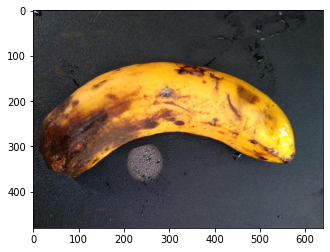

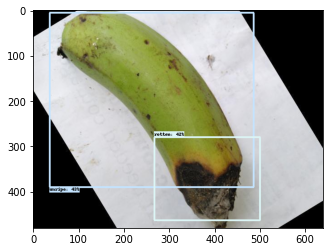

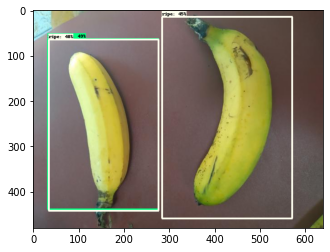

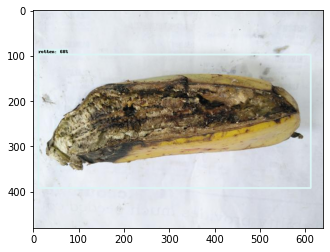

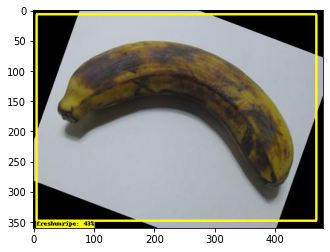

...

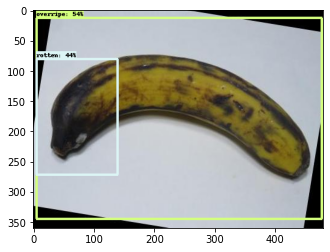

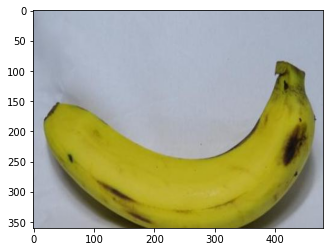

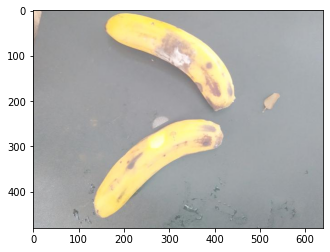

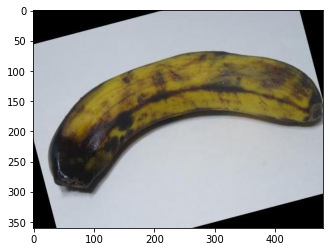

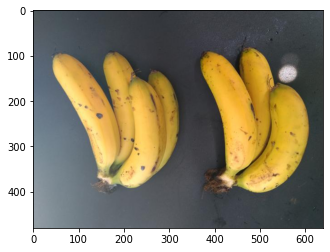

In [ ]:
for i in image_filenames[:1000]:
  detect_func(i)

# Graph Freezing

In [58]:
FREEZE_SCRIPT = os.path.join(workspaces['TFOD_API_PATH'], 'models', 'research', 'object_detection', 'exporter_main_v2.py')

In [59]:
command = "python {} --input_type=image_tensor --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(FREEZE_SCRIPT ,files['PIPELINE_CONFIG'], workspaces['CHECKPOINT_PATH'], workspaces['OUTPUT_PATH'])

In [60]:
print(command)

python Tensorflow/models/research/object_detection/exporter_main_v2.py --input_type=image_tensor --pipeline_config_path=Tensorflow/workspace/my_model_zoo/pipeline.config --trained_checkpoint_dir=Tensorflow/workspace/my_model_zoo --output_directory=Tensorflow/workspace/my_model_zoo/export


In [61]:
!{command}

2021-11-03 04:46:53.998834: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:46:54.021750: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:46:54.022497: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:46:54.033044: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:46:54.033785: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

# Tensorflow Javascript (TFJS) Conversion

In [62]:
!pip install tensorflowjs

     |████████████████████████████████| 64 kB 1.9 MB/s 


In [63]:
command = "tensorflowjs_converter --input_format=tf_saved_model --output_node_names='detection_boxes,detection_classes,detection_features,detection_multiclass_scores,detection_scores,num_detections,raw_detection_boxes,raw_detection_scores' --output_format=tfjs_graph_model --signature_name=serving_default {} {}".format(os.path.join(workspaces['OUTPUT_PATH'], 'saved_model'), workspaces['TFJS_PATH'])

In [64]:
print(command)

tensorflowjs_converter --input_format=tf_saved_model --output_node_names='detection_boxes,detection_classes,detection_features,detection_multiclass_scores,detection_scores,num_detections,raw_detection_boxes,raw_detection_scores' --output_format=tfjs_graph_model --signature_name=serving_default Tensorflow/workspace/my_model_zoo/export/saved_model Tensorflow/workspace/my_model_zoo/tfjsexport


In [65]:
!{command}

2021-11-03 04:48:12.336497: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:12.346753: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:12.347460: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:12.348646: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:12.349385: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

# TF Lite Conversion

In [66]:
!tar -zxvf /content/drive/Shareddrives/Capstone_Project/Models/ssd_mobilenet_v2_fpnlite_320x320_coco17_tpu-8_finalv3.tar.gz

Tensorflow/workspace/my_model_zoo/
Tensorflow/workspace/my_model_zoo/pipeline.config
Tensorflow/workspace/my_model_zoo/ckpt-1.data-00000-of-00001
Tensorflow/workspace/my_model_zoo/train/
Tensorflow/workspace/my_model_zoo/train/events.out.tfevents.1633939245.7d2d14ae0f92.714.0.v2
Tensorflow/workspace/my_model_zoo/tfliteexport/
Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/
Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/variables/
Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/variables/variables.index
Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/variables/variables.data-00000-of-00001
Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/assets/
Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/saved_model.pb
Tensorflow/workspace/my_model_zoo/ckpt-2.data-00000-of-00001
Tensorflow/workspace/my_model_zoo/checkpoint
Tensorflow/workspace/my_model_zoo/ckpt-1.index
Tensorflow/workspace/my_model_zoo/ckpt-3.data-00000-of-00001
Ten

In [67]:
TFLITE_SCRIPT = os.path.join(workspaces['TFOD_API_PATH'], 'models', 'research', 'object_detection', 'export_tflite_graph_tf2.py')

In [68]:
command = "python {} --pipeline_config_path={} --trained_checkpoint_dir={} --output_directory={}".format(TFLITE_SCRIPT ,files['PIPELINE_CONFIG'], workspaces['CHECKPOINT_PATH'], workspaces['TFLITE_PATH'])

In [69]:
print(command)

python Tensorflow/models/research/object_detection/export_tflite_graph_tf2.py --pipeline_config_path=Tensorflow/workspace/my_model_zoo/pipeline.config --trained_checkpoint_dir=Tensorflow/workspace/my_model_zoo --output_directory=Tensorflow/workspace/my_model_zoo/tfliteexport


In [70]:
!{command}

2021-11-03 04:48:54.951981: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:54.962127: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:54.962865: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:54.973395: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:48:54.974213: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:937] successful NUMA node read from S

In [71]:
FROZEN_TFLITE_PATH = os.path.join(workspaces['TFLITE_PATH'], 'saved_model')
TFLITE_MODEL = os.path.join(workspaces['TFLITE_PATH'], 'saved_model', 'detect.tflite')

In [72]:
command = "tflite_convert \
--saved_model_dir={} \
--output_file={} \
--input_shapes=1,300,300,3 \
--input_arrays=normalized_input_image_tensor \
--output_arrays='TFLite_Detection_PostProcess','TFLite_Detection_PostProcess:1','TFLite_Detection_PostProcess:2','TFLite_Detection_PostProcess:3' \
--inference_type=FLOAT \
--allow_custom_ops".format(FROZEN_TFLITE_PATH, TFLITE_MODEL, )

In [73]:
print(command)

tflite_convert --saved_model_dir=Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model --output_file=Tensorflow/workspace/my_model_zoo/tfliteexport/saved_model/detect.tflite --input_shapes=1,300,300,3 --input_arrays=normalized_input_image_tensor --output_arrays='TFLite_Detection_PostProcess','TFLite_Detection_PostProcess:1','TFLite_Detection_PostProcess:2','TFLite_Detection_PostProcess:3' --inference_type=FLOAT --allow_custom_ops


In [74]:
!{command}

2021-11-03 04:49:56.932485: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcuda.so.1
2021-11-03 04:49:56.963119: I tensorflow/stream_executor/cuda/cuda_gpu_executor.cc:981] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero
2021-11-03 04:49:56.963895: I tensorflow/core/common_runtime/gpu/gpu_device.cc:1555] Found device 0 with properties: 
pciBusID: 0000:00:04.0 name: Tesla K80 computeCapability: 3.7
coreClock: 0.8235GHz coreCount: 13 deviceMemorySize: 11.17GiB deviceMemoryBandwidth: 223.96GiB/s
2021-11-03 04:49:57.015191: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcudart.so.10.1
2021-11-03 04:49:57.237636: I tensorflow/stream_executor/platform/default/dso_loader.cc:44] Successfully opened dynamic library libcublas.so.10
2021-11-03 04:49:57.241229: I tensorflow/stream_executor/platform/defaul

# ZIP and Export Models

In [75]:
modelTar = "{}-FINAL-Version4.tar.gz".format(files['PRETRAINED_MODEL_NAME'])
!tar -czf {modelTar} {workspaces['CHECKPOINT_PATH']}

In [76]:
!mv {modelTar} /content/drive/Shareddrives/Capstone_Project/Models